# Feature Engineering notebook
Loads the lightweight clean data, and finds the most useful features for per-step awake classification 

## Imports

In [2]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
import seaborn as sns
import plotly.express as px
import gc

## Prepare data

In [3]:
data = pd.read_parquet('../../../data/raw/Zzzs_train.parquet')
data.rename(columns={'awake':'target'}, inplace=True)
data.head()

,series_id,step,timestamp,anglez,enmo,target
0,08db4255286f,0,2018-11-05T10:00:00-0400,-30.845301,0.0447,1
1,08db4255286f,1,2018-11-05T10:00:05-0400,-34.181801,0.0443,1
2,08db4255286f,2,2018-11-05T10:00:10-0400,-33.877102,0.0483,1
3,08db4255286f,3,2018-11-05T10:00:15-0400,-34.282101,0.0680,1
4,08db4255286f,4,2018-11-05T10:00:20-0400,-34.385799,0.0768,1


Determine train test split based on series_id, and add this as a column

In [4]:
sids = data.series_id.unique()
test_size = 0.2
np.random.seed(42)
np.random.shuffle(sids)
data['train'] = data.series_id.isin(sids[:-int(len(sids)*test_size)])

## Helper functions
Define a function that will be used to determine usefulness of a feature, by training a simple classifier on the feature, and returning the auroc score
Also add functions to show the results

In [5]:
def compute_feature_importance(df, feature, res_dict=None, plot=False, subsample=100, plot_limit=17280, plot_subsample=1):
    from sklearn.linear_model import LogisticRegression
    from sklearn.metrics import roc_auc_score
    cols = [feature, 'target','train']
    selection = df[cols][::subsample]
    train = selection[selection.train]
    test = selection[~selection.train]
    
    clf = LogisticRegression()
    clf.fit(train[[feature]], train.target)
    preds = clf.predict_proba(test[[feature]])[:,1]
    score = roc_auc_score(test.target, preds)
    
    if res_dict is not None:
        res_dict[feature] = score
        
    if plot:
        # plot with plotly
        print(f"AUROC: {score:.4f}")
        preds_df = pd.DataFrame({'target':test.target, 'pred':preds})
        preds_df = preds_df[:plot_limit:plot_subsample]
        fig = px.line(preds_df, x=range(len(preds_df)), y=['pred', 'target'])
        fig.show()    
    return score

In [6]:
res = dict()

In [7]:
def show_res(res, with_plotly=False):
    res_df = pd.DataFrame.from_dict(res, orient='index', columns=['auroc'])
    res_df.sort_values('auroc', ascending=False, inplace=True)
    
    if with_plotly:
        # plot with plotly
        fig = px.bar(res_df, x=res_df.index, y='auroc', title='Feature explanation power (logistic regression)')
        fig.show()
        return
    else:
        # plot with seaborn
        ax = sns.barplot(x=res_df.index, y=res_df.auroc, palette="deep")
        ax.bar_label(ax.containers[0], fmt='%.4f', label_type='edge')
        plt.xticks(rotation=45)
        plt.show()

# Let's start

Compute the importance of the standard features

  0%|          | 0/2 [00:00<?, ?it/s]

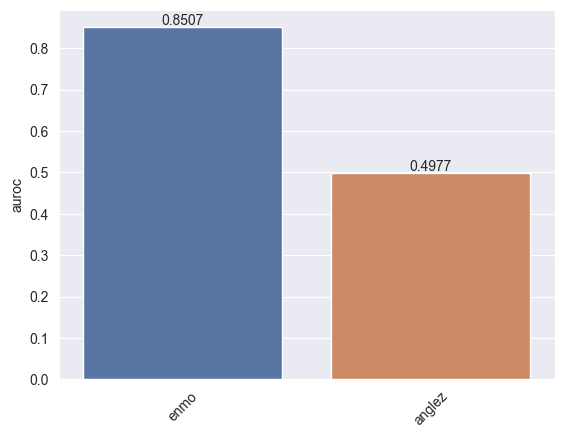

In [8]:
feats = ['anglez', 'enmo']
for feat in tqdm(feats):
    compute_feature_importance(data, feat, res)
show_res(res)

Add some features to make anglez more usable

Computing features


Computing feature importance:   0%|          | 0/3 [00:00<?, ?it/s]

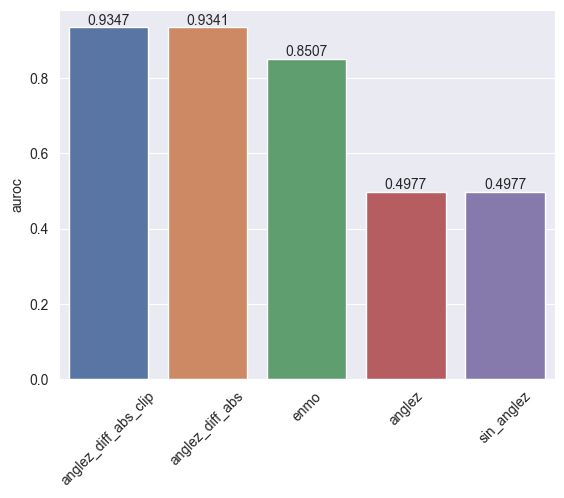

In [9]:
print('Computing features')
data['anglez_diff_abs'] = np.abs(data.anglez.diff()).fillna(0).astype(np.float32)
data['anglez_diff_abs_clip'] = np.clip(data.anglez_diff_abs, 0, 10).astype(np.float32)
data['sin_anglez'] = np.sin(data.anglez/180*np.pi).astype(np.float32)
feats = ['anglez_diff_abs', 'sin_anglez', 'anglez_diff_abs_clip']
for feat in tqdm(feats, desc='Computing feature importance'):
    if feat in res:
        continue
    compute_feature_importance(data, feat, res)
show_res(res)

Lets add the hour features, but instead of the value, use the proportion for which children are awake at that hour in the train set

Extracting hour from timestamp
Mapping hour to proportion of awake


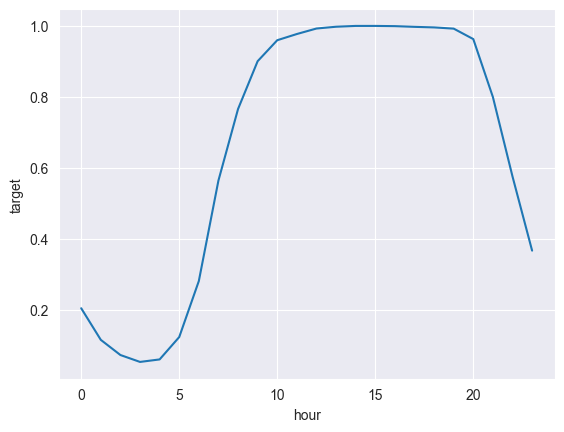

Smoothing the feature with a rolling mean
Computing feature importance


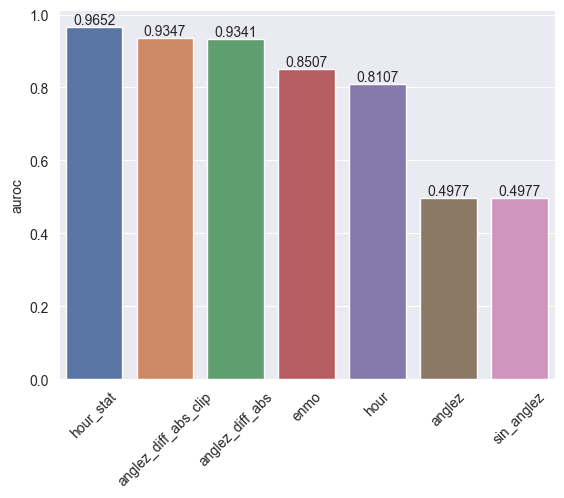

In [10]:
# since converting to timestamp is super slow, do it with substring, 
# using that the date format is like 2018-11-05T10:00:00-0400
print("Extracting hour from timestamp")
data['hour'] = data.timestamp.str[11:13].astype(int)

print("Mapping hour to proportion of awake")
hour_stats = data[data.train].groupby('hour').target.mean()
sns.lineplot(data=hour_stats)
plt.show()
data['hour_stat'] = data.hour.map(hour_stats)

print("Smoothing the feature with a rolling mean")
sec_per_step= 5
data['hour_stat'] = data.hour_stat.rolling(60*60//sec_per_step, center=True).mean().ffill().bfill().astype(np.float32)

print("Computing feature importance")
compute_feature_importance(data, 'hour', res)
compute_feature_importance(data, 'hour_stat', res)

show_res(res)

Also add the minute feature directly

Extracting minute from timestamp


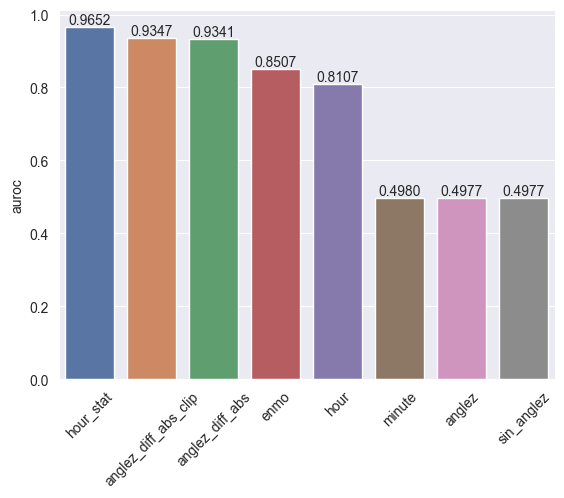

In [11]:
print("Extracting minute from timestamp")
data['minute'] = data.timestamp.str[14:16].astype(int)
compute_feature_importance(data, 'minute', res)
show_res(res)

These will form our basic features.
We distinguish which ones to compute a rolling window for.

In [12]:
basic_feats = ['enmo', 'anglez_diff_abs', 'anglez_diff_abs_clip', 'sin_anglez', 'hour', 'hour_stat']
basic_feats_for_rolling = ['enmo', 'anglez_diff_abs', 'anglez_diff_abs_clip', 'sin_anglez']

# Now let's add some rolling statistics

In [13]:
print("Computing rolling statistics")
stats = ['mean', 'std', 'min', 'max', 'median', 'skew','kurt']
window_sizes = [6, 12, 36, 50, 90, 180, 360, 500, 1000]
pbar = tqdm(total=len(stats)*len(basic_feats_for_rolling)*len(window_sizes))
new_feats = dict()
for stat in stats:
    for feat in basic_feats_for_rolling:
        for window_size in window_sizes:
            name = f'{feat}_{stat}_{window_size}'
            pbar.set_description(f'Computing {name}')
            if name not in data.columns:
                new_feats[name] = data[feat].rolling(window_size, center=True).agg(stat).ffill().bfill().astype(np.float32)
            pbar.update()
pbar.close()

# concatenate the new features with the original data
print("Concatenating new features")
new_feats_df = pd.DataFrame(new_feats)
data = pd.concat([data, new_feats_df], axis=1)
print("Cleaning up")
del new_feats_df
gc.collect()

Computing rolling statistics


  0%|          | 0/252 [00:00<?, ?it/s]

Concatenating new features


Compute a savgol filter, which is a moothing function

In [90]:
from scipy.signal import savgol_filter
window_sizes = [6, 12, 36, 50, 90, 180, 360, 500, 1000]
pbar = tqdm(total=len(window_sizes)*len(basic_feats_for_rolling))
savgol_feats = []
for window_size in window_sizes:
    for feat in basic_feats_for_rolling:
        name = f'{feat}_savgol_{window_size}'
        pbar.set_description(f'Computing {name}')
        if name not in data.columns:
            data[name] = savgol_filter(data[feat], window_size, 3)
        pbar.update()        
        savgol_feats.append(name)

  0%|          | 0/36 [00:00<?, ?it/s]

C:\Users\EmielW\AppData\Local\Temp\ipykernel_2948\41062013.py:10: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\EmielW\AppData\Local\Temp\ipykernel_2948\41062013.py:10: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\EmielW\AppData\Local\Temp\ipykernel_2948\41062013.py:10: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented fra

In [98]:
if 'data' in locals():
    data.to_parquet('../../../data/processed/Zzzs_train_features.parquet')
else:
    data = pd.read_parquet('../../../data/processed/Zzzs_train_features.parquet')

In [100]:
rolling_feats = [f for f in data.columns if any([stat in f for stat in stats])]
pbar = tqdm(rolling_feats + savgol_feats)
for feat in pbar:
    pbar.set_description(f'Computing explaining power of {feat}')
    if feat in res:
        continue
    compute_feature_importance(data, feat, res) 
pbar.close()

  0%|          | 0/337 [00:00<?, ?it/s]

In [101]:
show_res(res, with_plotly=True)

Compute the correlation between the features (with a subset of the data for performance reasons)
We can use this to select features that are not too correlated.

In [17]:
def select_useful_uncorrelated(data, res, subsample=1000):
    data_corr = data[::subsample].corr(numeric_only=True)
    
    # select features by sorting the res descending, and removing features that are too correlated to the ones that came before
    selection = []
    res_df = pd.DataFrame.from_dict(res, orient='index', columns=['auroc'])
    res_df.sort_values('auroc', ascending=False, inplace=True)
    
    for feat in res_df.index:
        if len(selection) == 0:
            selection.append(feat)
            continue
        if data_corr.loc[feat, selection].abs().max() < 0.9:
            selection.append(feat)
    
    print(f"Selected {len(selection)} features out of {len(res)}")
    print(selection)
    return data_corr, selection
    

In [102]:
data_corr, selection_long = select_useful_uncorrelated(data, res, subsample=1000)

Selected 190 features out of 344
['anglez_diff_abs_clip_skew_1000', 'anglez_diff_abs_clip_mean_1000', 'anglez_diff_abs_clip_kurt_1000', 'anglez_diff_abs_clip_skew_500', 'anglez_diff_abs_kurt_1000', 'anglez_diff_abs_clip_kurt_500', 'anglez_diff_abs_clip_skew_360', 'anglez_diff_abs_clip_median_360', 'enmo_mean_1000', 'enmo_std_500', 'anglez_diff_abs_median_90', 'anglez_diff_abs_kurt_500', 'anglez_diff_abs_clip_std_360', 'anglez_diff_abs_clip_mean_36', 'enmo_mean_360', 'enmo_max_1000', 'hour_stat', 'anglez_diff_abs_clip_median_12', 'enmo_std_180', 'anglez_diff_abs_clip_skew_180', 'enmo_max_360', 'anglez_diff_abs_clip_std_90', 'anglez_diff_abs_std_1000', 'anglez_diff_abs_median_6', 'anglez_diff_abs_clip_min_12', 'anglez_diff_abs_min_6', 'enmo_std_50', 'anglez_diff_abs_mean_12', 'anglez_diff_abs_min_36', 'anglez_diff_abs_kurt_360', 'enmo_mean_90', 'enmo_max_90', 'anglez_diff_abs_std_360', 'enmo_std_12', 'anglez_diff_abs_clip_min_50', 'enmo_std_6', 'anglez_diff_abs_clip', 'sin_anglez_std_6',

## Plotting
Plot the result of a predictor trained on all features

In [51]:
def train_model(data, feats, plot_preds=False, target='target', plot_days=5, plot_subsample=1):
    from catboost import CatBoostClassifier
    from sklearn.metrics import roc_auc_score
    train = data[data.train]
    test = data[~data.train]
    clf = CatBoostClassifier(eval_metric='AUC')
    clf.fit(train[feats], train[target], eval_set=(test[feats], test[target]), early_stopping_rounds=5)
    preds = clf.predict_proba(test[feats])[:,1]
    auroc = roc_auc_score(test[target], preds)
    print(f"AUROC: {auroc:.4f}")
    
    if plot_preds:
        # plot with plotly detailed
        df = pd.DataFrame({'preds': preds, 'target': test[target]})
        df_display = df[:plot_days*17280:plot_subsample]
        fig = px.line(df_display, x=range(len(df_display)), y=['preds', 'target'])
        fig.show()
    
    return clf, auroc

In [106]:
clf_long, _ = train_model(data, basic_feats + rolling_feats + savgol_feats, plot_preds=True)

Learning rate set to 0.309538
0:	test: 0.9938335	best: 0.9938335 (0)	total: 1.67s	remaining: 27m 45s
1:	test: 0.9950115	best: 0.9950115 (1)	total: 3.1s	remaining: 25m 45s
2:	test: 0.9957073	best: 0.9957073 (2)	total: 4.36s	remaining: 24m 7s
3:	test: 0.9960076	best: 0.9960076 (3)	total: 5.75s	remaining: 23m 51s
4:	test: 0.9962734	best: 0.9962734 (4)	total: 7.01s	remaining: 23m 15s
5:	test: 0.9962901	best: 0.9962901 (5)	total: 8.45s	remaining: 23m 20s
6:	test: 0.9964104	best: 0.9964104 (6)	total: 9.79s	remaining: 23m 8s
7:	test: 0.9965712	best: 0.9965712 (7)	total: 11.2s	remaining: 23m 3s
8:	test: 0.9965744	best: 0.9965744 (8)	total: 12.4s	remaining: 22m 47s
9:	test: 0.9965658	best: 0.9965744 (8)	total: 13.6s	remaining: 22m 24s
10:	test: 0.9965489	best: 0.9965744 (8)	total: 14.7s	remaining: 22m 4s
11:	test: 0.9965468	best: 0.9965744 (8)	total: 16s	remaining: 21m 54s
12:	test: 0.9965503	best: 0.9965744 (8)	total: 16.9s	remaining: 21m 23s
13:	test: 0.9965598	best: 0.9965744 (8)	total: 18s	

In [21]:
def get_importances(clf, feats, plot=True):
    importances = clf.get_feature_importance()
    importances_df = pd.DataFrame({'feature':feats, 'importance':importances})
    importances_df.importance /= importances_df.importance.sum()
    importances_df.sort_values('importance', ascending=False, inplace=True)
    if plot:
        fig = px.bar(importances_df, x='feature', y='importance')
        fig.show()
    return importances_df

In [107]:
importances_long = get_importances(clf_long, basic_feats + rolling_feats + savgol_feats)

# Precise dataset
So far we have measured AUROC across the entire day. Preferring features that are good for a high-level overview.
Now we will try to predict awake for only the short windows around transitions of the target.

In [109]:
# first compute the transitions
window_size = 180
data['transition'] = (data.target != data.target.shift(1)).astype(int)
data['window'] = data.transition.rolling(window_size, center=True).sum().ffill().bfill()

In [110]:
# plot the first few windows
data_start = data[:50000:18][['step', 'target', 'window']]
px.scatter(data_start, x='step', y='target', color='window')

Ran into some memory issues here when filtering the dataset, so lets print the memory usage for debugging purposes

In [111]:
import gc
mem = data.memory_usage().sum()/(1024**3)
print(f"Dataframe size before selection: {mem:.2f} GB")
gc.collect()

Dataframe size before selection: 18.06 GB


9028

In [112]:
# make a new dataset with only the windows
data_windows = data[data.window>0].copy()
mem = data_windows.memory_usage().sum()/(1024**3)
print(f"Datafram after selection: {mem:.2f} GB")
gc.collect()

Datafram after selection: 0.38 GB


0

# Precise datset feature importance

In [113]:
res_windows = dict()
feats = basic_feats + rolling_feats + savgol_feats
pbar = tqdm(feats)
for feat in pbar:
    pbar.set_description(f'Computing explaining power of {feat}')
    if feat in res_windows:
        continue
    compute_feature_importance(data_windows, feat, res_windows)

  0%|          | 0/343 [00:00<?, ?it/s]

In [114]:
show_res(res_windows, with_plotly=True)

In [115]:
# select features by sorting the res descending, and removing features that are too correlated to the ones that came before
data_corr_short, selection_short = select_useful_uncorrelated(data_windows, res_windows, subsample=10)

Selected 205 features out of 343
['anglez_diff_abs_clip_savgol_180', 'anglez_diff_abs_savgol_90', 'anglez_diff_abs_clip_std_90', 'anglez_diff_abs_std_90', 'anglez_diff_abs_std_50', 'anglez_diff_abs_clip_std_50', 'enmo_std_50', 'anglez_diff_abs_clip_skew_180', 'anglez_diff_abs_mean_180', 'enmo_std_90', 'anglez_diff_abs_clip_std_180', 'sin_anglez_std_50', 'anglez_diff_abs_clip_skew_90', 'anglez_diff_abs_clip_median_90', 'anglez_diff_abs_clip_kurt_90', 'anglez_diff_abs_median_180', 'anglez_diff_abs_median_360', 'sin_anglez_std_90', 'enmo_savgol_180', 'anglez_diff_abs_median_36', 'anglez_diff_abs_clip_mean_12', 'anglez_diff_abs_std_180', 'anglez_diff_abs_clip_max_36', 'anglez_diff_abs_clip_max_50', 'anglez_diff_abs_max_12', 'anglez_diff_abs_clip_mean_360', 'anglez_diff_abs_clip_max_12', 'anglez_diff_abs_kurt_180', 'enmo_std_12', 'enmo_mean_180', 'anglez_diff_abs_clip_skew_360', 'anglez_diff_abs_clip_kurt_360', 'anglez_diff_abs_mean_6', 'anglez_diff_abs_clip_max_6', 'anglez_diff_abs_median_

# Lets visualize the predictions of a model trained on the precise dataset

In [116]:
clf_short, auroc = train_model(data_windows, feats, plot_preds=True, plot_days=1, plot_subsample=1)

Learning rate set to 0.118809
0:	test: 0.8991436	best: 0.8991436 (0)	total: 69.8ms	remaining: 1m 9s
1:	test: 0.9111982	best: 0.9111982 (1)	total: 138ms	remaining: 1m 8s
2:	test: 0.9162972	best: 0.9162972 (2)	total: 197ms	remaining: 1m 5s
3:	test: 0.9179508	best: 0.9179508 (3)	total: 249ms	remaining: 1m 2s
4:	test: 0.9204099	best: 0.9204099 (4)	total: 297ms	remaining: 59.1s
5:	test: 0.9222622	best: 0.9222622 (5)	total: 345ms	remaining: 57.1s
6:	test: 0.9241543	best: 0.9241543 (6)	total: 391ms	remaining: 55.4s
7:	test: 0.9243868	best: 0.9243868 (7)	total: 441ms	remaining: 54.7s
8:	test: 0.9247324	best: 0.9247324 (8)	total: 487ms	remaining: 53.6s
9:	test: 0.9248557	best: 0.9248557 (9)	total: 535ms	remaining: 52.9s
10:	test: 0.9257238	best: 0.9257238 (10)	total: 581ms	remaining: 52.2s
11:	test: 0.9261343	best: 0.9261343 (11)	total: 628ms	remaining: 51.7s
12:	test: 0.9268959	best: 0.9268959 (12)	total: 669ms	remaining: 50.8s
13:	test: 0.9272893	best: 0.9272893 (13)	total: 712ms	remaining: 5

In [117]:
importances_short = get_importances(clf_short, feats)

In [118]:
# Repeat with selection
clf_short_selection, auroc = train_model(data_windows, selection_short, plot_preds=True, plot_days=1, plot_subsample=1)

Learning rate set to 0.118809
0:	test: 0.9120806	best: 0.9120806 (0)	total: 52ms	remaining: 51.9s
1:	test: 0.9200510	best: 0.9200510 (1)	total: 100ms	remaining: 50s
2:	test: 0.9205743	best: 0.9205743 (2)	total: 150ms	remaining: 49.9s
3:	test: 0.9213498	best: 0.9213498 (3)	total: 195ms	remaining: 48.5s
4:	test: 0.9219931	best: 0.9219931 (4)	total: 233ms	remaining: 46.4s
5:	test: 0.9226996	best: 0.9226996 (5)	total: 273ms	remaining: 45.3s
6:	test: 0.9235759	best: 0.9235759 (6)	total: 306ms	remaining: 43.5s
7:	test: 0.9239400	best: 0.9239400 (7)	total: 347ms	remaining: 43.1s
8:	test: 0.9246164	best: 0.9246164 (8)	total: 381ms	remaining: 42s
9:	test: 0.9253507	best: 0.9253507 (9)	total: 419ms	remaining: 41.5s
10:	test: 0.9261784	best: 0.9261784 (10)	total: 456ms	remaining: 41s
11:	test: 0.9265130	best: 0.9265130 (11)	total: 491ms	remaining: 40.4s
12:	test: 0.9267326	best: 0.9267326 (12)	total: 526ms	remaining: 39.9s
13:	test: 0.9274274	best: 0.9274274 (13)	total: 560ms	remaining: 39.4s
14:

In [119]:
importances_short = get_importances(clf_short, feats)

# Event features
These features work well for state segmentation. Now let's see which features work well for events. And add a few features that make more sense for events.
Starting by getting the moments (i.e. slope etc.) of the most important state segmentation features, for both long-term and precise.
Also add onset_stat and wakeup_stat.

In [120]:
# take the most important features from both long and short-term feature importance
threshold = 0.01
feats_long = importances_long[importances_long.importance>threshold].feature.tolist()
feats_short = importances_short[importances_short.importance>threshold].feature.tolist()
feats_good = list(set(feats_long + feats_short))

# combine them in a dataframe with importances
feats_df = pd.DataFrame({'feature':feats_good})
feats_df['importance_long'] = feats_df.feature.map(importances_long.set_index('feature').importance)
feats_df['importance_short'] = feats_df.feature.map(importances_short.set_index('feature').importance)

print(f"Selected {len(feats_good)} features")
print(feats_good)
feats_df

Selected 46 features
['anglez_diff_abs_clip_std_1000', 'anglez_diff_abs_clip_mean_90', 'enmo_std_1000', 'sin_anglez_median_180', 'anglez_diff_abs_clip_mean_50_diff', 'anglez_diff_abs_clip_mean_180', 'enmo_mean_1000', 'anglez_diff_abs_savgol_180', 'anglez_diff_abs_clip_skew_360', 'sin_anglez_min_1000', 'anglez_diff_abs_median_180', 'anglez_diff_abs_clip_savgol_360', 'anglez_diff_abs_max_36', 'hour_stat', 'anglez_diff_abs_median_1000', 'anglez_diff_abs_clip_skew_1000', 'enmo_max_500', 'enmo_median_90', 'anglez_diff_abs_std_1000', 'enmo_std_50', 'anglez_diff_abs_clip_median_360', 'enmo_std_90', 'anglez_diff_abs_median_500', 'sin_anglez_skew_180', 'enmo_max_180', 'enmo_mean_180', 'anglez_diff_abs_kurt_1000', 'anglez_diff_abs_clip_skew_50', 'anglez_diff_abs_clip_median_90', 'anglez_diff_abs_clip_median_1000', 'anglez_diff_abs_mean_36_diff', 'hour', 'anglez_diff_abs_median_90', 'sin_anglez_median_500', 'anglez_diff_abs_clip_savgol_180', 'sin_anglez_skew_1000', 'anglez_diff_abs_clip_mean_90_d

,feature,importance_long,importance_short
0,anglez_diff_abs_clip_std_1000,0.021366,0.000000
1,anglez_diff_abs_clip_mean_90,0.000000,0.019550
2,enmo_std_1000,0.013282,0.002940
3,sin_anglez_median_180,0.000000,0.011873
4,anglez_diff_abs_clip_mean_50_diff,0.000000,0.028706
5,anglez_diff_abs_clip_mean_180,0.010272,0.011731
6,enmo_mean_1000,0.000000,0.013148
7,anglez_diff_abs_savgol_180,0.000000,0.017430
8,anglez_diff_abs_clip_skew_360,0.010523,0.000000
9,sin_anglez_min_1000,0.048428,0.001993


Compute moments

In [121]:
# compute slope (diff)
print("Computing slope")
feats_moments = list()
for feat in tqdm(feats_good):
    name = f'{feat}_diff'
    if name not in data.columns:
        data[name] = data[feat].diff().fillna(0).astype(np.float32)
    if name not in feats_moments:
        feats_moments.append(name)

Computing slope


  0%|          | 0/46 [00:00<?, ?it/s]

In [ ]:
# Create event labels, which are the diff of awake
print("Computing event labels")
data['event_wakeup'] = data.target.diff().fillna(0).astype(int).clip(0,1)

Compute the event stat feature

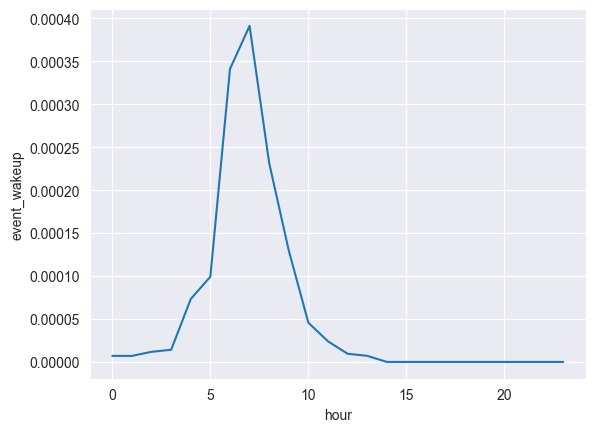

In [122]:
hour_wakeup_stats = data[data.train].groupby('hour')['event_wakeup'].mean()
data['hour_wakeup_stat'] = data.hour.map(hour_wakeup_stats)
sns.lineplot(data=hour_wakeup_stats)
plt.show()

Train a model

In [124]:
# train a model on events 
print("Training event model")
feats = list(set(feats_good + feats_moments + ['hour_wakeup_stat']))
gc.collect()
clf_event, auroc = train_model(data, feats, target='event_wakeup', plot_preds=True, plot_days=5, plot_subsample=1)

Training event model
Learning rate set to 0.309538
0:	test: 0.7844095	best: 0.7844095 (0)	total: 685ms	remaining: 11m 24s
1:	test: 0.7931886	best: 0.7931886 (1)	total: 1.27s	remaining: 10m 34s
2:	test: 0.8127008	best: 0.8127008 (2)	total: 1.87s	remaining: 10m 21s
3:	test: 0.9116752	best: 0.9116752 (3)	total: 2.45s	remaining: 10m 9s
4:	test: 0.9683270	best: 0.9683270 (4)	total: 3.04s	remaining: 10m 5s
5:	test: 0.9824294	best: 0.9824294 (5)	total: 3.64s	remaining: 10m 3s
6:	test: 0.9885828	best: 0.9885828 (6)	total: 4.21s	remaining: 9m 57s
7:	test: 0.9893684	best: 0.9893684 (7)	total: 4.74s	remaining: 9m 47s
8:	test: 0.9896563	best: 0.9896563 (8)	total: 5.29s	remaining: 9m 42s
9:	test: 0.9905804	best: 0.9905804 (9)	total: 5.88s	remaining: 9m 41s
10:	test: 0.9912335	best: 0.9912335 (10)	total: 6.46s	remaining: 9m 41s
11:	test: 0.9926668	best: 0.9926668 (11)	total: 7.17s	remaining: 9m 50s
12:	test: 0.9926247	best: 0.9926668 (11)	total: 7.79s	remaining: 9m 51s
13:	test: 0.9927603	best: 0.99

In [125]:
# show importances
importances_event = get_importances(clf_event, feats)

# Get a performance estimate

Computing error


  0%|          | 0/172 [00:00<?, ?it/s]

Plotting error


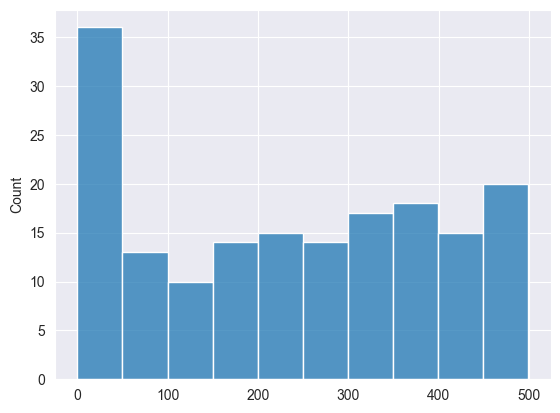

In [126]:
test = data[~data.train]
preds = clf_event.predict_proba(test[feats])[:,1]
target = test.event_wakeup

# iterate over all wakeups, get the argmax of the preds within 500 steps, and compute the distance
# this is a bit slow, but it's only for evaluation
print("Computing error")
errors = []
for onset in tqdm(test[test.event_wakeup==1].step):
    preds_window = preds[onset-500:onset+500]
    pred = preds_window.argmax()
    error = np.abs(pred-500)
    errors.append(error)
    
    sns.lineplot(x=np.arange(-500,500,1), y=preds_window)
    plt.axvline(x=0, color='red')
    plt.savefig(f'./plots/pred_{onset}')
    plt.close()
    
# show a histogram of the errors
print("Plotting error")
sns.histplot(errors, bins=10)
plt.show()